## Parpadeo

### Integrantes:
- Carapia Barcena Mauricio Javier.
- Landeros Castellanos Jared Noe.
- Martínez Arroyo Edgar Rodrigo.
- Peña Bravo María Cecilia.
- Romero Olaéz Gustavo.

In [1]:
#Importación de la biblioteca OpenCV (cv2) para el visionado.
import cv2

#Importación de la biblioteca NumPy para el manejo eficiente de matrices y arreglos.
import numpy as np

#Importación de la biblioteca matplotlib.pyplot para la visualización de gráficos y figuras.
from matplotlib import pyplot as plt

## Declaraciones

In [2]:
##videoParpadeo = cv2.VideoCapture('./video/videoParpadeo.mp4')
framesParpadeo = []

for i in range(80):
    nombre_archivo = f'./cuadrosParpadeo/frame{i+1}.jpg'
    framesParpadeo.append(nombre_archivo)

imagenes_parpadeo = [cv2.cvtColor(cv2.imread(ruta), cv2.COLOR_BGR2RGB) for ruta in framesParpadeo]


## Guardado imagenes

In [3]:
def visualizarGuardarImg(imagen, nombre, arreglo, imprimir=True):
    if imprimir:
        plt.imshow(imagen)
        # Pausa brevemente la ejecución para permitir que la imagen se muestre en la ventana de Matplotlib.
        plt.pause(0.03)
    
    # Guarda la imagen en el disco con el nombre especificado y vuelve a convertir los colores para respetar la tonalidad original.
    imagen = cv2.convertScaleAbs(imagen)
    cv2.imwrite(nombre, cv2.cvtColor(imagen, cv2.COLOR_RGB2BGR))
    arreglo.append(nombre)

## Obtener cuadros


In [4]:
def obtenerCuadros(video, arregloParaAlmacenarImg, cuadros=10, rutaNombre =  './cuadrosDesplazamiento/frame', imprimir = True):
    cont = 0
    while True: #Lee los cuadros dentro del ciclo.
        ret, cuadro = video.read()
        
         #Verifica si la lectura del cuadro fue exitosa (ret es True) o si se ha llegado al final del video (ret es False).
        if not ret:
            break
        
        cuadroRGB = cv2.cvtColor(cuadro, cv2.COLOR_BGR2RGB)
        cont += 1

        nombre = f'{rutaNombre}{cont}.jpg'
        
        visualizarGuardarImg(cuadroRGB, nombre, arregloParaAlmacenarImg, imprimir)

        if cuadros is not None and cont >= cuadros:
            break
        
    #Deja de usar el recurso.
    video.release() 
    plt.close('all')

## Implementacion

In [2]:
## NO EJECUTAR
obtenerCuadros(videoParpadeo, framesParpadeo, 80, './cuadrosParpadeo/frame', False)

NameError: name 'obtenerCuadros' is not defined

In [5]:
def preprocesar_imagen(imagen):
    #Preprocesa la imagen para el análisis.
   
    # Convertir a escala de grises
    gris = cv2.cvtColor(imagen, cv2.COLOR_BGR2GRAY)
    # Aplicar filtro Gaussiano
    suavizado = cv2.GaussianBlur(gris, (15, 15), 0)
    # Aplicar detector de bordes Canny
    bordes = cv2.Canny(suavizado, 30, 100)
    return bordes

In [6]:
def calcular_diferencia(imagen1, imagen2):
   
    # Calcula la diferencia binarizada entre dos imágenes.
   
    # Calcular la diferencia absoluta
    diferencia = cv2.absdiff(imagen1, imagen2)
    # Binarizar el resultado
    _, binarizada = cv2.threshold(diferencia, 20, 255, cv2.THRESH_BINARY)
    return binarizada

In [7]:
#Si se mueve umbral_cambio cambia el conteo el chido es .002 (minutos de pruebas)

def contar_parpadeos(frames_preprocesados, umbral_cambio=0.002 ):
    #Cuenta los parpadeos en una serie de frames preprocesados.
    conteo_parpadeos = 0
    cambio_previo = 0

    for i in range(1, len(frames_preprocesados)):
        cambio = calcular_diferencia(frames_preprocesados[i - 1], frames_preprocesados[i])
        porcentaje_cambio = np.sum(cambio == 255) / (cambio.shape[0] * cambio.shape[1])

        if porcentaje_cambio > umbral_cambio and cambio_previo < umbral_cambio:
            conteo_parpadeos += 1

        cambio_previo = porcentaje_cambio

    return conteo_parpadeos

In [8]:
def analizar_parpadeos(frames):
   
    #Analiza una serie de frames para contar los parpadeos.
    
    # Preprocesar los frames
    frames_preprocesados = [preprocesar_imagen(frame) for frame in frames]
    # Contar los parpadeos
    num_parpadeos = contar_parpadeos(frames_preprocesados)
    return num_parpadeos

In [9]:

def analizar_parpadeos_visualmente(frames):
    centroides_x = []
    centroides_y = []

    for i, frame in enumerate(frames):
        # 1. Convertir la imagen a escala de grises
        imagen_gris = cv2.cvtColor(frame, cv2.COLOR_RGB2GRAY)

        # 2. Aplicar un filtro Gaussiano
        imagen_filtrada = cv2.GaussianBlur(imagen_gris, (15, 15), 0)

        # 3. Aplicar el detector de bordes Canny
        bordes = cv2.Canny(imagen_filtrada, 30, 100)

        # 4. Encontrar contornos en la imagen de bordes
        contornos, _ = cv2.findContours(bordes, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        imagen_contornos = frame.copy()
        cv2.drawContours(imagen_contornos, contornos, -1, (255, 0, 0), 2)  # Dibujar contornos en rojo

        # 5. Mostrar la diferencia entre frames si i>0
        imagen_dif = np.zeros_like(imagen_gris)
        if i > 0:
            imagen_dif = calcular_diferencia(frames[i-1], frame)

        # Mostrar las imágenes en cada paso
        fig, axes = plt.subplots(1, 5, figsize=(20, 4))
        axes[0].imshow(frame)
        axes[0].set_title('Imagen Original')
        axes[0].axis('off')

        axes[1].imshow(imagen_gris, cmap='gray')
        axes[1].set_title('Escala de Grises')
        axes[1].axis('off')

        axes[2].imshow(imagen_filtrada, cmap='gray')
        axes[2].set_title('Filtro Gaussiano')
        axes[2].axis('off')

        axes[3].imshow(bordes, cmap='gray')
        axes[3].set_title('Filtro Canny')
        axes[3].axis('off')

        axes[4].imshow(imagen_dif, cmap='gray')
        axes[4].set_title('Diferencia entre Frames')
        axes[4].axis('off')

        plt.show()

Número de parpadeos detectados: 2


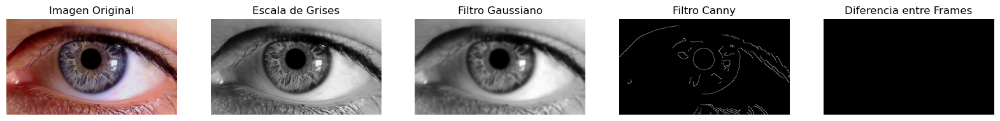

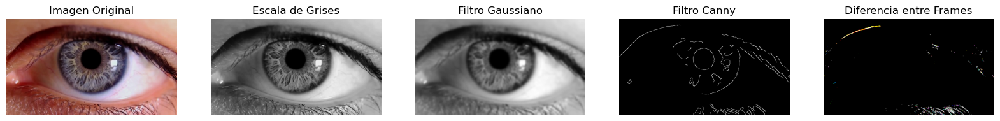

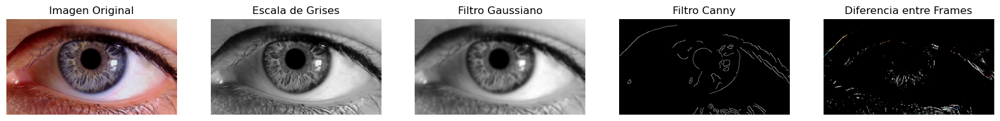

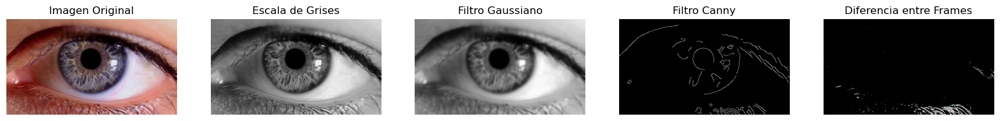

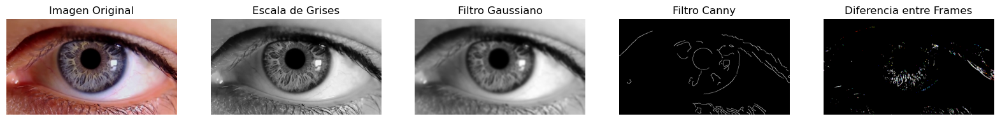

...

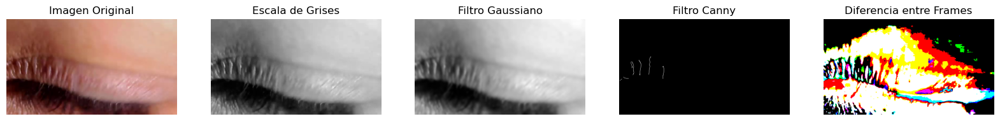

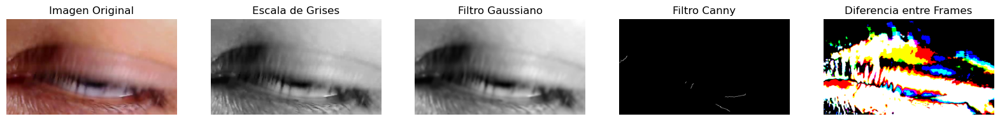

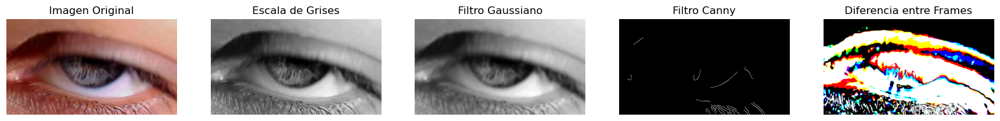

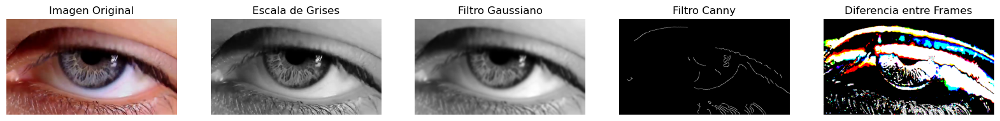

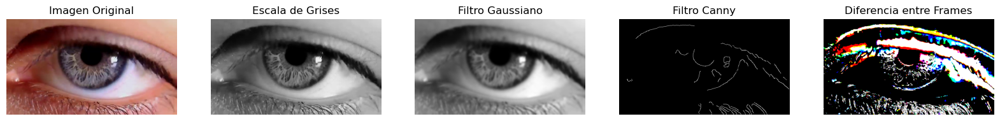

In [10]:
num_parpadeos = analizar_parpadeos(imagenes_parpadeo)
print("Número de parpadeos detectados:", num_parpadeos)
analizar_parpadeos_visualmente(imagenes_parpadeo)